In [1]:
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2' 

import numpy as np
import matplotlib.path as mpath
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap, ListedColormap, to_rgba
import matplotlib.ticker as mticker
import xarray as xr
import cartopy.crs as ccrs
import cartopy.feature as cfeature

from sklearn.preprocessing import StandardScaler
from sklearn.metrics import ConfusionMatrixDisplay

import tensorflow as tf
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Dense, Reshape, Flatten, Input, Dropout, BatchNormalization, Concatenate
from tensorflow.keras.optimizers import Adam, SGD, RMSprop
from tensorflow import keras 

from pickle import dump, load

In [2]:
scaler = load(open(f'Data_Step2/control/scaler.pkl', 'rb'))
scaler.mean_, scaler.scale_

(array([-2.85953411e-11,  3.68473248e+03, -2.93517822e-01, -1.78395655e-05,
         7.85527389e-05,  2.14230237e-03,  4.95123948e-07,  6.49555247e-07,
         3.01111445e+08, -1.45646523e+07]),
 array([1.86685043e-10, 1.61048766e+03, 7.99068436e-01, 1.03240757e-04,
        6.63678833e-01, 4.30530589e-02, 1.86624197e-05, 2.45397653e-06,
        1.35950753e+09, 9.36660921e+08]))

In [3]:
col_height = xr.open_dataset(f'Data_Step2/control/col_height.nc').rename({'yh':'lat', 'xh':'lon'})['col_height']

# Ensure that longitude coords are from -180 to 180
col_height.coords['lon'] = (col_height.coords['lon'] + 180) % 360 - 180
col_height = col_height.sortby(col_height.lon)

In [4]:
experiment = 'historical'
num_clusters = 6

missingdataindex = np.load(f'Data_Step2/{experiment}/missingdataindex.npy')
maskTraining = np.load(f'Data_Step2/{experiment}/maskTraining.npy')
maskVal = np.load(f'Data_Step2/{experiment}/maskVal.npy')
maskTest = np.load(f'Data_Step2/{experiment}/maskTest.npy')

total_features = np.load(f'Data_Step2/{experiment}/total_features.npy')
train_features = np.load(f'Data_Step2/{experiment}/train_features.npy')
val_features = np.load(f'Data_Step2/{experiment}/val_features.npy')
test_features = np.load(f'Data_Step2/{experiment}/test_features.npy')

X_total_scaled = scaler.transform(total_features)
X_train_scaled = scaler.transform(train_features)
X_val_scaled = scaler.transform(val_features)
X_test_scaled = scaler.transform(test_features)

model_name = f'model_24x2_16x2_tanh_{num_clusters}_clusters'
ensemble_size = 50

prob_predictions = np.empty(shape=(ensemble_size, X_total_scaled.shape[0], num_clusters))
for i in range(ensemble_size):
    model = tf.keras.models.load_model(f'saved_models/{model_name}/model_{i}.h5')
    prob_predictions[i] = model(X_total_scaled).numpy()

prob_mean = prob_predictions.mean(axis = 0)

pred = np.nan * np.zeros((1080,1440))
pred[~missingdataindex] = prob_mean.argmax(axis=1)
pred = xr.DataArray(data=pred,
                    dims=['lat','lon'],
                    coords=dict(lat=col_height['lat'], lon=col_height['lon']),
                    name='Model Pred')

pred_probs = np.nan * np.zeros((1080,1440,6))
pred_probs[~missingdataindex] = prob_mean
pred_probs = xr.DataArray(data=pred_probs,
                          dims=['lat','lon','regime'],
                          coords=dict(lat=col_height['lat'], lon=col_height['lon'], regime=list(range(6))),
                          name='Prediction probabilities')

prob_predictions_swapped = np.swapaxes(prob_predictions, 0, 1)
pred_full = np.nan * np.zeros((1080,1440,ensemble_size,num_clusters))
pred_full[~missingdataindex] = prob_predictions_swapped
pred_full = xr.DataArray(data=pred_full,
                         dims=['lat','lon','member', 'label'],
                         coords=dict(lat=col_height['lat'], lon=col_height['lon'],
                                     member=list(range(ensemble_size)), label=list(range(num_clusters))),
                         name='Predictions')

entropy_vals = -np.sum(prob_mean* np.log2(prob_mean), axis=1)
entropy = np.nan * np.zeros((1080,1440))
entropy[~missingdataindex] = entropy_vals
entropy = xr.DataArray(data=entropy,
                       dims=['lat','lon'],
                       coords=dict(lat=col_height['lat'], lon=col_height['lon']),
                       name='Entropy')

experiment_one = experiment
pred_one = pred
pred_probs_one = pred_probs
pred_full_one = pred_full
entropy_one = entropy

In [5]:
experiment = 'ssp585_2080_2099'
num_clusters = 6

missingdataindex = np.load(f'Data_Step2/{experiment}/missingdataindex.npy')
maskTraining = np.load(f'Data_Step2/{experiment}/maskTraining.npy')
maskVal = np.load(f'Data_Step2/{experiment}/maskVal.npy')
maskTest = np.load(f'Data_Step2/{experiment}/maskTest.npy')

total_features = np.load(f'Data_Step2/{experiment}/total_features.npy')
train_features = np.load(f'Data_Step2/{experiment}/train_features.npy')
val_features = np.load(f'Data_Step2/{experiment}/val_features.npy')
test_features = np.load(f'Data_Step2/{experiment}/test_features.npy')

X_total_scaled = scaler.transform(total_features)
X_train_scaled = scaler.transform(train_features)
X_val_scaled = scaler.transform(val_features)
X_test_scaled = scaler.transform(test_features)

model_name = f'model_24x2_16x2_tanh_{num_clusters}_clusters'
ensemble_size = 50

prob_predictions = np.empty(shape=(ensemble_size, X_total_scaled.shape[0], num_clusters))
for i in range(ensemble_size):
    model = tf.keras.models.load_model(f'saved_models/{model_name}/model_{i}.h5')
    prob_predictions[i] = model(X_total_scaled).numpy()

prob_mean = prob_predictions.mean(axis = 0)

pred = np.nan * np.zeros((1080,1440))
pred[~missingdataindex] = prob_mean.argmax(axis=1)
pred = xr.DataArray(data=pred,
                    dims=['lat','lon'],
                    coords=dict(lat=col_height['lat'], lon=col_height['lon']),
                    name='Model Pred')

pred_probs = np.nan * np.zeros((1080,1440,6))
pred_probs[~missingdataindex] = prob_mean
pred_probs = xr.DataArray(data=pred_probs,
                          dims=['lat','lon','regime'],
                          coords=dict(lat=col_height['lat'], lon=col_height['lon'], regime=list(range(6))),
                          name='Prediction probabilities')

prob_predictions_swapped = np.swapaxes(prob_predictions, 0, 1)
pred_full = np.nan * np.zeros((1080,1440,ensemble_size,num_clusters))
pred_full[~missingdataindex] = prob_predictions_swapped
pred_full = xr.DataArray(data=pred_full,
                         dims=['lat','lon','member', 'label'],
                         coords=dict(lat=col_height['lat'], lon=col_height['lon'],
                                     member=list(range(ensemble_size)), label=list(range(num_clusters))),
                         name='Predictions')

entropy_vals = -np.sum(prob_mean* np.log2(prob_mean), axis=1)
entropy = np.nan * np.zeros((1080,1440))
entropy[~missingdataindex] = entropy_vals
entropy = xr.DataArray(data=entropy,
                       dims=['lat','lon'],
                       coords=dict(lat=col_height['lat'], lon=col_height['lon']),
                       name='Entropy')

experiment_two = experiment
pred_two = pred
pred_probs_two = pred_probs
pred_full_two = pred_full
entropy_two = entropy

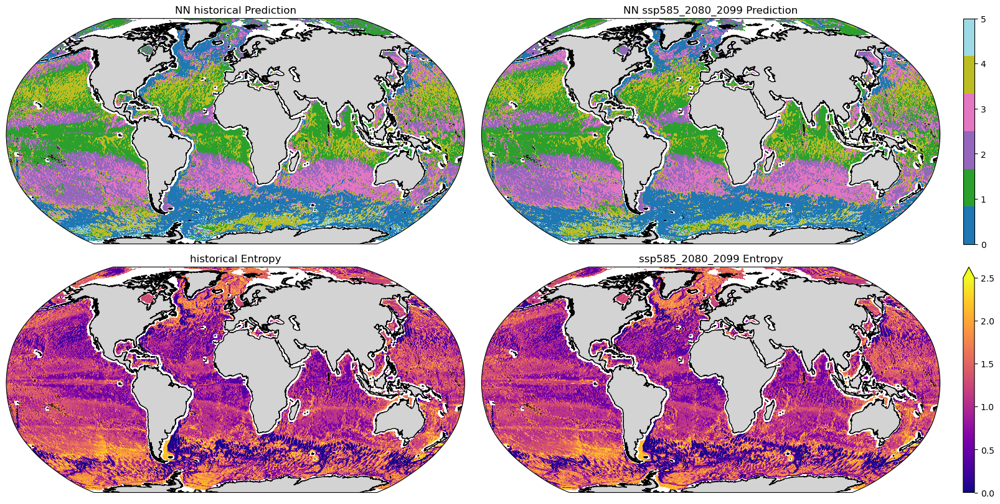

In [6]:
fig, axes = plt.subplots(2, 2, subplot_kw={'projection':ccrs.Robinson()}, figsize=(16,8), constrained_layout=True)

pred_one.plot(ax=axes[0,0], transform=ccrs.PlateCarree(), cmap=plt.get_cmap('tab20', num_clusters), add_colorbar=False)

pred_two.plot(ax=axes[0,1], transform=ccrs.PlateCarree(), cmap=plt.get_cmap('tab20', num_clusters), cbar_kwargs={'label':''})

entropy_one.plot(ax=axes[1,0], transform=ccrs.PlateCarree(), cmap='plasma', vmin=0, vmax=2.5, add_colorbar=False)

entropy_two.plot(ax=axes[1,1], transform=ccrs.PlateCarree(), cmap='plasma', vmin=0, vmax=2.5, cbar_kwargs={'label':''})

for i in range(2):
    for j in range(2):
        axes[i,j].add_feature(cfeature.LAND, facecolor='lightgrey')
        axes[i,j].coastlines(resolution='10m')
        '''
        xr.plot.contour(col_height, ax=axes[i,j],
                        transform=ccrs.PlateCarree(), colors='black', linewidths=0.5)
        gl = axes[i,j].gridlines(crs=ccrs.PlateCarree(), linewidth=1, color='black', alpha=0.5, linestyle='--', draw_labels=True)
        gl.top_labels = False
        gl.right_labels = False
        '''
    
axes[0,0].set_title(f'NN {experiment_one} Prediction')
axes[0,1].set_title(f'NN {experiment_two} Prediction')
axes[1,0].set_title(f'{experiment_one} Entropy')
axes[1,1].set_title(f'{experiment_two} Entropy')

plt.show()

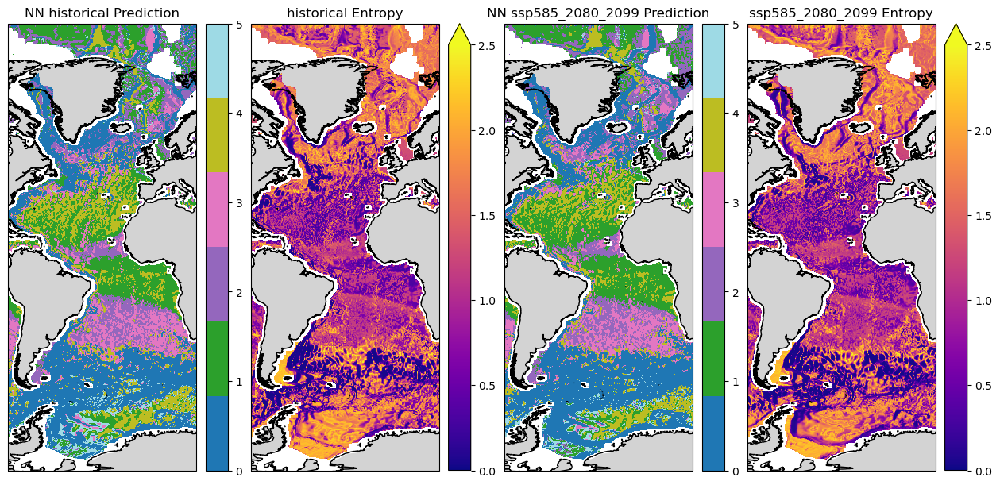

In [7]:
fig, axes = plt.subplots(1, 4, subplot_kw={'projection':ccrs.Miller()}, figsize=(12.5,6), constrained_layout=True)

pred_one.isel(lon=slice(400,800)).plot(ax=axes[0], transform=ccrs.PlateCarree(),
                                              cmap=plt.get_cmap('tab20', num_clusters), cbar_kwargs={'label':''})

entropy_one.isel(lon=slice(400,800)).plot(ax=axes[1], transform=ccrs.PlateCarree(),
                                                 cmap='plasma', vmin=0, vmax=2.5, cbar_kwargs={'label':''})

pred_two.isel(lon=slice(400,800)).plot(ax=axes[2], transform=ccrs.PlateCarree(),
                                          cmap=plt.get_cmap('tab20', num_clusters), cbar_kwargs={'label':''})

entropy_two.isel(lon=slice(400,800)).plot(ax=axes[3], transform=ccrs.PlateCarree(),
                                             cmap='plasma', vmin=0, vmax=2.5, cbar_kwargs={'label':''})

axes[0].set_title(f'NN {experiment_one} Prediction')
axes[0].add_feature(cfeature.LAND, facecolor='lightgrey')
axes[0].coastlines(resolution='10m')

axes[1].set_title(f'{experiment_one} Entropy')
axes[1].add_feature(cfeature.LAND, facecolor='lightgrey')
axes[1].coastlines(resolution='10m')

axes[2].set_title(f'NN {experiment_two} Prediction')
axes[2].add_feature(cfeature.LAND, facecolor='lightgrey')
axes[2].coastlines(resolution='10m')

axes[3].set_title(f'{experiment_two} Entropy')
axes[3].add_feature(cfeature.LAND, facecolor='lightgrey')
axes[3].coastlines(resolution='10m')

plt.show()

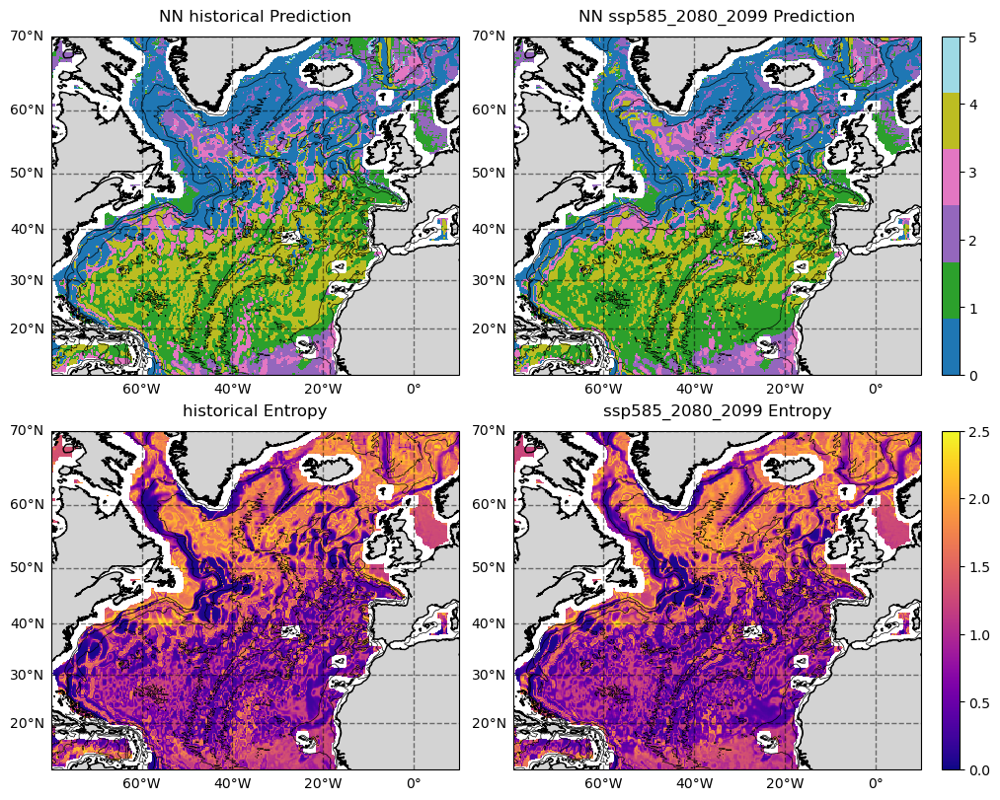

In [8]:
fig, axes = plt.subplots(2, 2, subplot_kw={'projection':ccrs.Miller()}, figsize=(10,8), constrained_layout=True)

pred_one.sel(lon=slice(-80,10)).sel(lat=slice(10,70)).plot(ax=axes[0,0], transform=ccrs.PlateCarree(),
                                                                  cmap=plt.get_cmap('tab20', num_clusters), add_colorbar=False)

pred_two.sel(lon=slice(-80,10)).sel(lat=slice(10,70)).plot(ax=axes[0,1], transform=ccrs.PlateCarree(),
                                                              cmap=plt.get_cmap('tab20', num_clusters), cbar_kwargs={'label':''})

entropy_one.sel(lon=slice(-80,10)).sel(lat=slice(10,70)).plot(ax=axes[1,0], transform=ccrs.PlateCarree(),
                                                          cmap='plasma', vmin=0, vmax=2.5, add_colorbar=False)

entropy_two.sel(lon=slice(-80,10)).sel(lat=slice(10,70)).plot(ax=axes[1,1], transform=ccrs.PlateCarree(),
                                                          cmap='plasma', vmin=0, vmax=2.5, cbar_kwargs={'label':''})

for i in range(2):
    for j in range(2):
        axes[i,j].add_feature(cfeature.LAND, facecolor='lightgrey')
        axes[i,j].coastlines(resolution='10m')
        xr.plot.contour(col_height.sel(lon=slice(-80,10)).sel(lat=slice(10,70)), ax=axes[i,j],
                        transform=ccrs.PlateCarree(), colors='black', linewidths=0.5)
        gl = axes[i,j].gridlines(crs=ccrs.PlateCarree(), linewidth=1, color='black', alpha=0.5, linestyle='--', draw_labels=True)
        gl.top_labels = False
        gl.right_labels = False
    
axes[0,0].set_title(f'NN {experiment_one} Prediction')
axes[0,1].set_title(f'NN {experiment_two} Prediction')
axes[1,0].set_title(f'{experiment_one} Entropy')
axes[1,1].set_title(f'{experiment_two} Entropy')

plt.show()

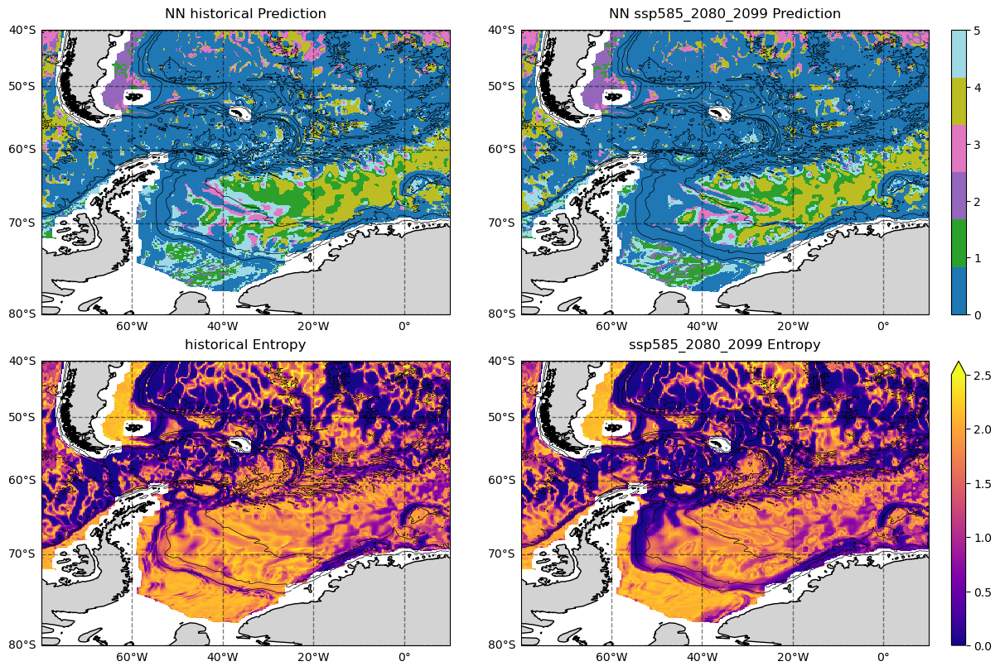

In [9]:
fig, axes = plt.subplots(2, 2, subplot_kw={'projection':ccrs.Miller()}, figsize=(12,8), constrained_layout=True)

pred_one.sel(lon=slice(-80,10)).sel(lat=slice(-80,-40)).plot(ax=axes[0,0], transform=ccrs.PlateCarree(),
                                                                  cmap=plt.get_cmap('tab20', num_clusters), add_colorbar=False)

pred_two.sel(lon=slice(-80,10)).sel(lat=slice(-80,-40)).plot(ax=axes[0,1], transform=ccrs.PlateCarree(),
                                                              cmap=plt.get_cmap('tab20', num_clusters), cbar_kwargs={'label':''})

entropy_one.sel(lon=slice(-80,10)).sel(lat=slice(-80,-40)).plot(ax=axes[1,0], transform=ccrs.PlateCarree(),
                                                          cmap='plasma', vmin=0, vmax=2.5, add_colorbar=False)

entropy_two.sel(lon=slice(-80,10)).sel(lat=slice(-80,-40)).plot(ax=axes[1,1], transform=ccrs.PlateCarree(),
                                                          cmap='plasma', vmin=0, vmax=2.5, cbar_kwargs={'label':''})

for i in range(2):
    for j in range(2):
        axes[i,j].add_feature(cfeature.LAND, facecolor='lightgrey')
        axes[i,j].coastlines(resolution='10m')
        xr.plot.contour(col_height.sel(lon=slice(-80,10)).sel(lat=slice(-80,-40)), ax=axes[i,j],
                        transform=ccrs.PlateCarree(), colors='black', linewidths=0.5)
        gl = axes[i,j].gridlines(crs=ccrs.PlateCarree(), linewidth=1, color='black', alpha=0.5, linestyle='--', draw_labels=True)
        gl.top_labels = False
        gl.right_labels = False
    
axes[0,0].set_title(f'NN {experiment_one} Prediction')
axes[0,1].set_title(f'NN {experiment_two} Prediction')
axes[1,0].set_title(f'{experiment_one} Entropy')
axes[1,1].set_title(f'{experiment_two} Entropy')

plt.show()

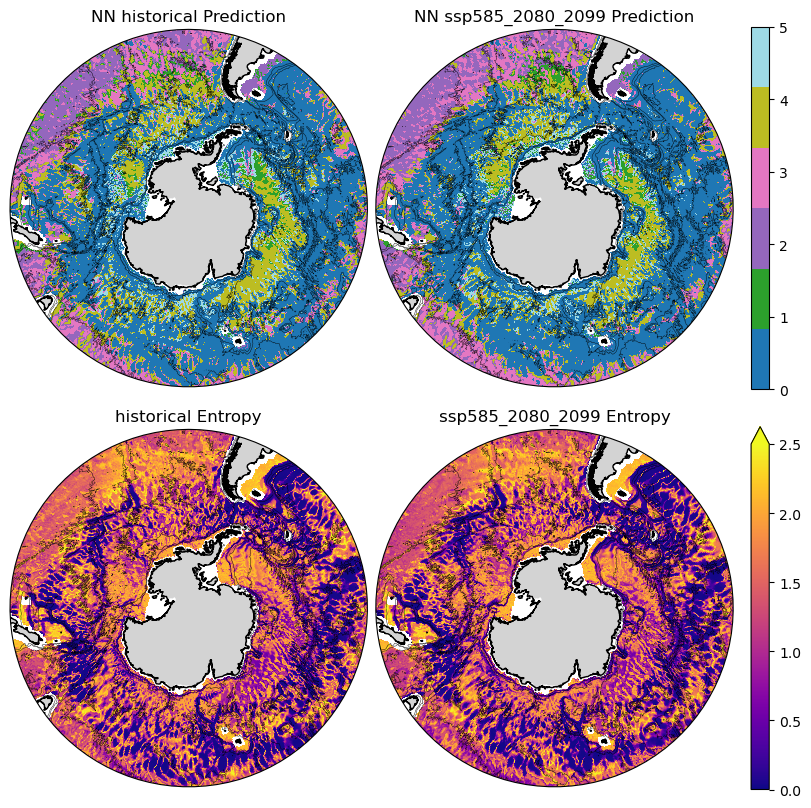

In [45]:
fig, axes = plt.subplots(2, 2, subplot_kw={'projection':ccrs.SouthPolarStereo(central_longitude=-90)}, figsize=(8,8), constrained_layout=True)

pred_one.sel(lat=slice(-90,-40)).plot(ax=axes[0,0], transform=ccrs.PlateCarree(),
                                                                  cmap=plt.get_cmap('tab20', num_clusters), add_colorbar=False)

pred_two.sel(lat=slice(-90,-40)).plot(ax=axes[0,1], transform=ccrs.PlateCarree(),
                                                              cmap=plt.get_cmap('tab20', num_clusters), cbar_kwargs={'label':''})

entropy_one.sel(lat=slice(-90,-40)).plot(ax=axes[1,0], transform=ccrs.PlateCarree(),
                                                          cmap='plasma', vmin=0, vmax=2.5, add_colorbar=False)

entropy_two.sel(lat=slice(-90,-40)).plot(ax=axes[1,1], transform=ccrs.PlateCarree(),
                                                          cmap='plasma', vmin=0, vmax=2.5, cbar_kwargs={'label':''})

# Compute a circle in axes coordinates, which we can use as a boundary
# for the map. We can pan/zoom as much as we like - the boundary will be
# permanently circular.
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)

for i in range(2):
    for j in range(2):
        axes[i,j].add_feature(cfeature.LAND, facecolor='lightgrey')
        axes[i,j].coastlines(resolution='10m')
        axes[i,j].set_boundary(circle, transform=axes[i,j].transAxes)
        xr.plot.contour(col_height.sel(lat=slice(-90,-40)), ax=axes[i,j],
                        transform=ccrs.PlateCarree(), colors='black', linewidths=0.3)
        '''
        gl = axes[i,j].gridlines(crs=ccrs.PlateCarree(), linewidth=1, color='black', alpha=0.5, linestyle='--', draw_labels=True)
        gl.top_labels = False
        gl.right_labels = False
        '''
    
axes[0,0].set_title(f'NN {experiment_one} Prediction')
axes[0,1].set_title(f'NN {experiment_two} Prediction')
axes[1,0].set_title(f'{experiment_one} Entropy')
axes[1,1].set_title(f'{experiment_two} Entropy')

plt.savefig(f'figures/2023-07-26/southern_ocean_regimes_and_entropy.png', dpi=600)
plt.show()

In [11]:
def plot_regime_shift_natlantic(regime, row):
    regime_one = xr.where(pred_one == regime, regime, np.nan)
    regime_two = xr.where(pred_two == regime, regime, np.nan)

    difference = xr.where((regime_one == regime) & (regime_two == regime), 0, np.nan)
    difference = xr.where((regime_two == regime) & np.isnan(regime_one), -1, difference)
    difference = xr.where((regime_one == regime) & np.isnan(regime_two), -2, difference)
    
    cmap_colors = [[0.5019607843137255, 0.0, 0.5019607843137255, 1.0],
                   [0.0, 0.5019607843137255, 0.0, 1.0],
                   [0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 1.0]]
    new_cmap = ListedColormap(cmap_colors)

    to_plot = difference.sel(lon=slice(-80,10)).sel(lat=slice(10,70))
    pcm = to_plot.plot(ax=axes[row,0], transform=ccrs.PlateCarree(), cmap=new_cmap,
                       vmin=-2, vmax=0, add_colorbar=False)
    my_cbar = fig.colorbar(pcm, ax=axes[row,0], ticks=[-2,-1,0])
    my_cbar.ax.set_yticklabels(['Replaced', 'Displaced', f'Regime {regime}'])

    entropy_masked = xr.where(~np.isnan(difference), entropy, np.nan)
    to_plot = entropy_masked.sel(lon=slice(-80,10)).sel(lat=slice(10,70))
    to_plot.plot(ax=axes[row,1], transform=ccrs.PlateCarree(), cmap='plasma',
                 vmin=0, vmax=2.5)
    
    for i in range(2):
        axes[row,i].add_feature(cfeature.LAND, facecolor='lightgrey')
        axes[row,i].coastlines(resolution='10m')
        
def plot_regime_shift_socean(regime, row):
    regime_one = xr.where(pred_one == regime, regime, np.nan)
    regime_two = xr.where(pred_two == regime, regime, np.nan)

    difference = xr.where((regime_one == regime) & (regime_two == regime), 0, np.nan)
    difference = xr.where((regime_two == regime) & np.isnan(regime_one), -1, difference)
    difference = xr.where((regime_one == regime) & np.isnan(regime_two), -2, difference)
    
    cmap_colors = [[0.5019607843137255, 0.0, 0.5019607843137255, 1.0],
                   [0.0, 0.5019607843137255, 0.0, 1.0],
                   [0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 1.0]]
    new_cmap = ListedColormap(cmap_colors)

    to_plot = difference.sel(lon=slice(-80,10)).sel(lat=slice(-80,-40))
    pcm = to_plot.plot(ax=axes[row,0], transform=ccrs.PlateCarree(), cmap=new_cmap,
                       vmin=-2, vmax=0, add_colorbar=False)
    my_cbar = fig.colorbar(pcm, ax=axes[row,0], ticks=[-2,-1,0])
    my_cbar.ax.set_yticklabels(['Replaced', 'Displaced', f'Regime {regime}'])

    entropy_masked = xr.where(~np.isnan(difference), entropy, np.nan)
    to_plot = entropy_masked.sel(lon=slice(-80,10)).sel(lat=slice(-80,-40))
    to_plot.plot(ax=axes[row,1], transform=ccrs.PlateCarree(), cmap='plasma',
                 vmin=0, vmax=2.5)
    
    for i in range(2):
        axes[row,i].add_feature(cfeature.LAND, facecolor='lightgrey')
        axes[row,i].coastlines(resolution='10m')

def plot_regime_shift_socean_full(regime, row):
    regime_one = xr.where(pred_one == regime, regime, np.nan)
    regime_two = xr.where(pred_two == regime, regime, np.nan)

    difference = xr.where((regime_one == regime) & (regime_two == regime), 0, np.nan)
    difference = xr.where((regime_two == regime) & np.isnan(regime_one), -1, difference)
    difference = xr.where((regime_one == regime) & np.isnan(regime_two), -2, difference)
    
    cmap_colors = [[0.5019607843137255, 0.0, 0.5019607843137255, 1.0],
                   [0.0, 0.5019607843137255, 0.0, 1.0],
                   [0.5019607843137255, 0.5019607843137255, 0.5019607843137255, 1.0]]
    new_cmap = ListedColormap(cmap_colors)

    to_plot = difference.sel(lat=slice(-90,-40))
    pcm = to_plot.plot(ax=axes[row,0], transform=ccrs.PlateCarree(), cmap=new_cmap,
                       vmin=-2, vmax=0, add_colorbar=False)
    my_cbar = fig.colorbar(pcm, ax=axes[row,0], ticks=[-2,-1,0])
    my_cbar.ax.set_yticklabels(['Replaced', 'Displaced', f'Regime {regime}'])

    entropy_masked = xr.where(~np.isnan(difference), entropy, np.nan)
    to_plot = entropy_masked.sel(lat=slice(-90,-40))
    to_plot.plot(ax=axes[row,1], transform=ccrs.PlateCarree(), cmap='plasma',
                 vmin=0, vmax=2.5)
    
    # Compute a circle in axes coordinates, which we can use as a boundary
    # for the map. We can pan/zoom as much as we like - the boundary will be
    # permanently circular.
    theta = np.linspace(0, 2*np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)
    
    for i in range(2):
        axes[row,i].add_feature(cfeature.LAND, facecolor='lightgrey')
        axes[row,i].coastlines(resolution='10m')
        axes[row,i].set_boundary(circle, transform=axes[row,i].transAxes)

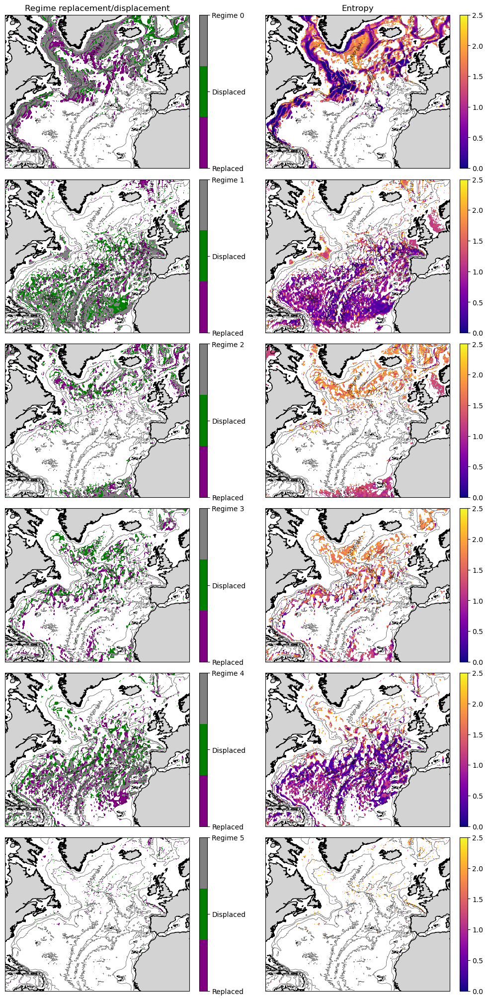

In [12]:
fig, axes = plt.subplots(num_clusters, 2, subplot_kw={'projection':ccrs.Miller()}, figsize=(10,20), constrained_layout=True)

for regime in range(num_clusters):
    plot_regime_shift_natlantic(regime, row=regime)
    
for i in range(num_clusters):
    for j in range(2):
        xr.plot.contour(col_height.sel(lon=slice(-80,10)).sel(lat=slice(10,70)), ax=axes[i,j],
                        transform=ccrs.PlateCarree(), colors='black', alpha=0.75, linewidths=0.5)

axes[0,0].set_title('Regime replacement/displacement')
axes[0,1].set_title('Entropy')

plt.show()

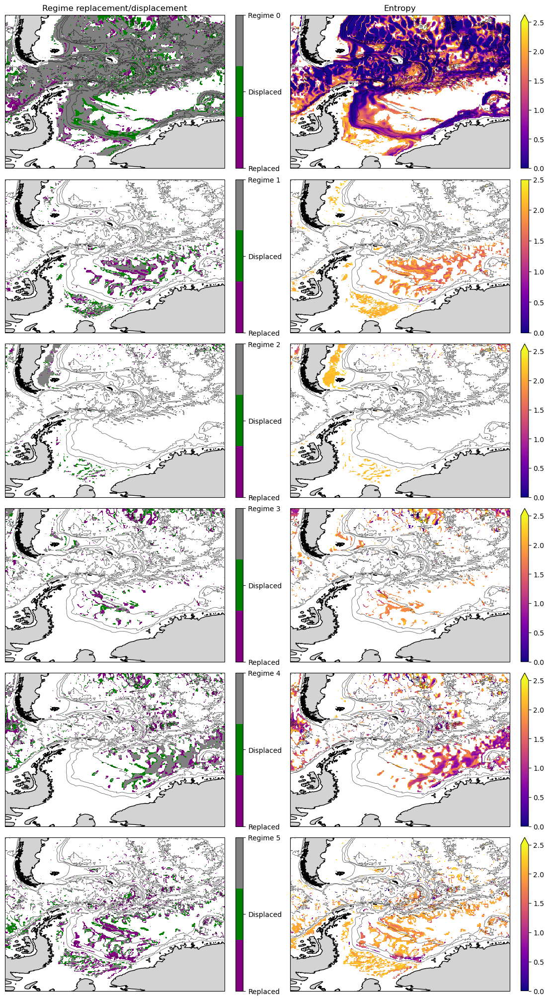

In [13]:
fig, axes = plt.subplots(num_clusters, 2, subplot_kw={'projection':ccrs.Miller()}, figsize=(11,20), constrained_layout=True)

for regime in range(num_clusters):
    plot_regime_shift_socean(regime, row=regime)
    
for i in range(num_clusters):
    for j in range(2):
        xr.plot.contour(col_height.sel(lon=slice(-80,10)).sel(lat=slice(-80,-40)), ax=axes[i,j],
                        transform=ccrs.PlateCarree(), colors='black', alpha=0.75, linewidths=0.5)

axes[0,0].set_title('Regime replacement/displacement')
axes[0,1].set_title('Entropy')

plt.show()

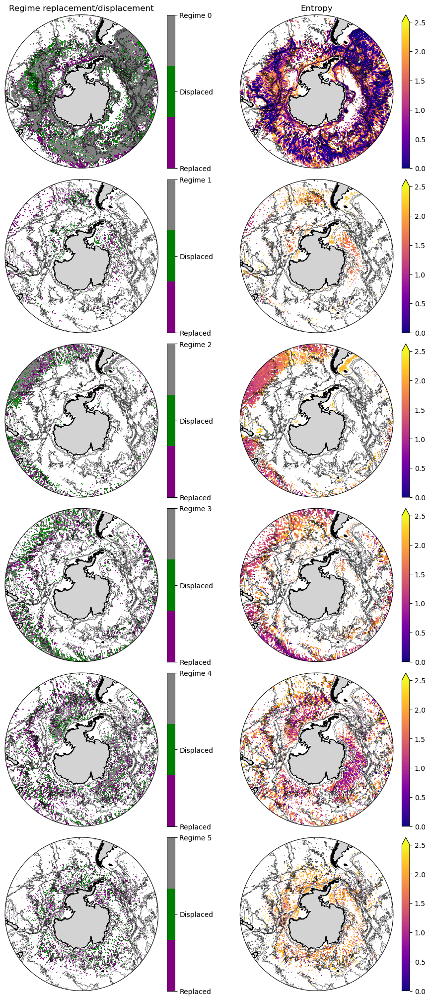

In [46]:
fig, axes = plt.subplots(num_clusters, 2, subplot_kw={'projection':ccrs.SouthPolarStereo(central_longitude=-90)}, figsize=(9,20), constrained_layout=True)

for regime in range(num_clusters):
    plot_regime_shift_socean_full(regime, row=regime)
    
for i in range(num_clusters):
    for j in range(2):
        xr.plot.contour(col_height.sel(lat=slice(-90,-40)), ax=axes[i,j],
                        transform=ccrs.PlateCarree(), colors='black', alpha=0.75, linewidths=0.5)

axes[0,0].set_title('Regime replacement/displacement')
axes[0,1].set_title('Entropy')

plt.savefig(f'figures/2023-07-26/southern_ocean_regime_growth_decay_and_entropy.png', dpi=600)
plt.show()

# Entropy comparisons

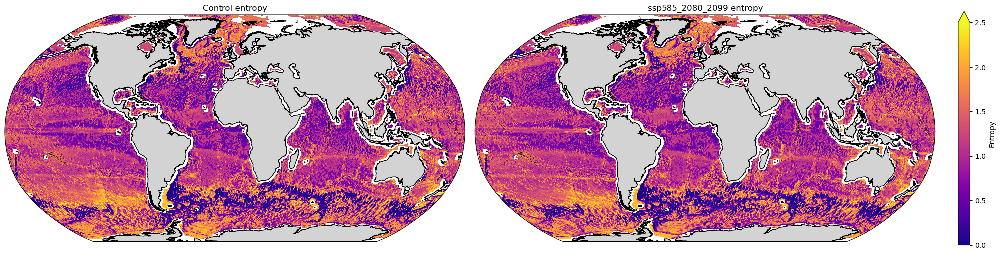

In [15]:
fig, axes = plt.subplots(1, 2, subplot_kw={'projection':ccrs.Robinson()}, figsize=(20,5), constrained_layout=True)

entropy_one.plot(ax=axes[0], transform=ccrs.PlateCarree(), cmap='plasma', vmin=0, vmax=2.5, add_colorbar=False)

entropy_two.plot(ax=axes[1], transform=ccrs.PlateCarree(), cmap='plasma', vmin=0, vmax=2.5)

axes[0].set_title('Control entropy')
axes[1].set_title(f'{experiment} entropy')

for i in range(2):
    axes[i].add_feature(cfeature.LAND, facecolor='lightgrey')
    axes[i].coastlines(resolution='10m')

plt.show()

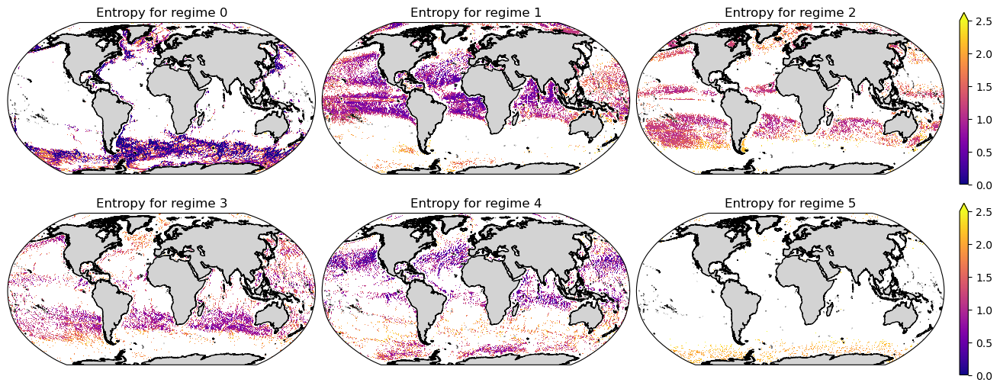

In [16]:
fig, axes = plt.subplots(2, 3, subplot_kw={'projection':ccrs.Robinson()}, figsize=(13,5), constrained_layout=True)

for i in range(num_clusters):
    
    entropy_by_regime = xr.where(pred_two == i, entropy_two, np.nan)
    
    add_cbar = False
    if i % 3 == 2:
        add_cbar = True
        
    entropy_by_regime.plot(ax=axes[i//3,i%3], transform=ccrs.PlateCarree(), cmap='plasma', vmin=0, vmax=2.5, add_colorbar=add_cbar)
    
    axes[i//3,i%3].add_feature(cfeature.LAND, facecolor='lightgrey')
    axes[i//3,i%3].coastlines(resolution='10m')
    axes[i//3,i%3].set_title(f'Entropy for regime {i}')
    
plt.show()

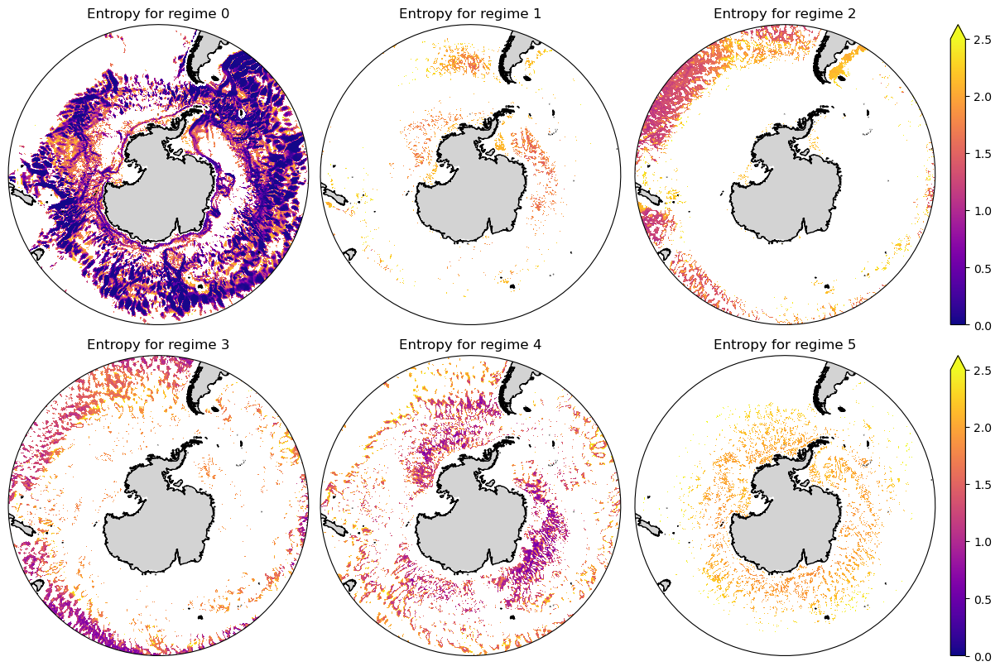

In [17]:
fig, axes = plt.subplots(2, 3, subplot_kw={'projection':ccrs.SouthPolarStereo(central_longitude=-90)}, figsize=(12,8), constrained_layout=True)

# Compute a circle in axes coordinates, which we can use as a boundary
# for the map. We can pan/zoom as much as we like - the boundary will be
# permanently circular.
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)

for i in range(num_clusters):
    
    entropy_by_regime = xr.where(pred_two == i, entropy_two, np.nan).sel(lat=slice(-90,-40))
    
    add_cbar = False
    if i % 3 == 2:
        add_cbar = True
        
    entropy_by_regime.plot(ax=axes[i//3,i%3], transform=ccrs.PlateCarree(), cmap='plasma', vmin=0, vmax=2.5, add_colorbar=add_cbar)
    
    axes[i//3,i%3].add_feature(cfeature.LAND, facecolor='lightgrey')
    axes[i//3,i%3].coastlines(resolution='10m')
    axes[i//3,i%3].set_boundary(circle, transform=axes[i//3,i%3].transAxes)
    axes[i//3,i%3].set_title(f'Entropy for regime {i}')
    
plt.show()

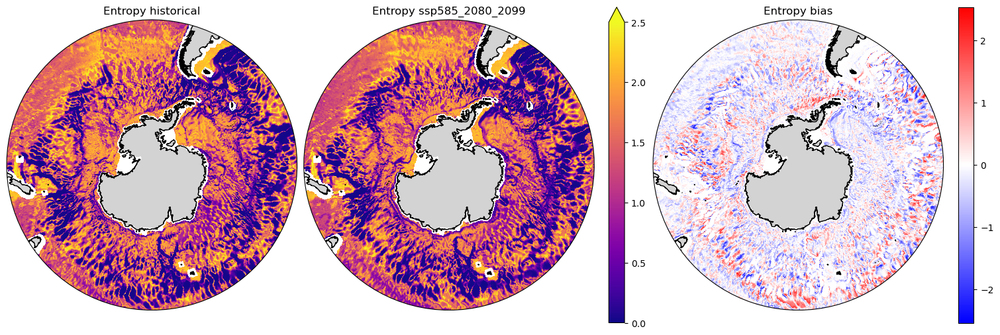

In [47]:
fig, axes = plt.subplots(1, 3, subplot_kw={'projection':ccrs.SouthPolarStereo(central_longitude=-90)}, figsize=(15,5), constrained_layout=True)

# Compute a circle in axes coordinates, which we can use as a boundary
# for the map. We can pan/zoom as much as we like - the boundary will be
# permanently circular.
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)

entropy_one.sel(lat=slice(-90,-40)).plot(ax=axes[0], transform=ccrs.PlateCarree(), cmap='plasma', add_colorbar=False, vmin=0, vmax=2.5)
entropy_two.sel(lat=slice(-90,-40)).plot(ax=axes[1], transform=ccrs.PlateCarree(), cmap='plasma', cbar_kwargs={'label':''}, vmin=0, vmax=2.5)

entropy_bias = entropy_two - entropy_one
entropy_bias.sel(lat=slice(-90,-40)).plot(ax=axes[2], transform=ccrs.PlateCarree(), cmap='bwr', cbar_kwargs={'label':''})

axes[0].set_title(f'Entropy {experiment_one}')
axes[1].set_title(f'Entropy {experiment_two}')
axes[2].set_title(f'Entropy bias')

for i in range(3):
    axes[i].add_feature(cfeature.LAND, facecolor='lightgrey')
    axes[i].coastlines(resolution='10m')
    axes[i].set_boundary(circle, transform=axes[i].transAxes)

plt.savefig(f'figures/2023-07-26/southern_ocean_entropy_and_bias.png', dpi=600)
plt.show()

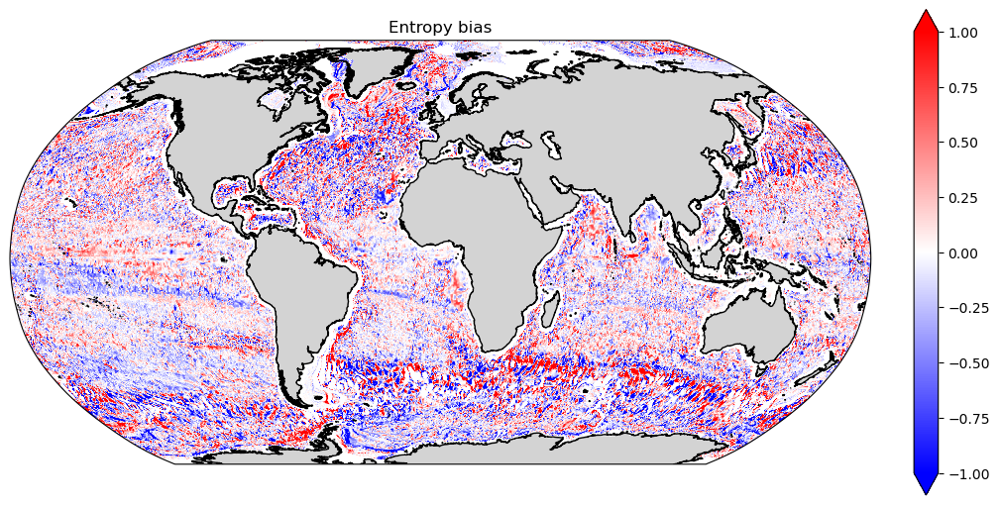

In [19]:
fig, axes = plt.subplots(1, 1, subplot_kw={'projection':ccrs.Robinson()}, figsize=(10,5), constrained_layout=True)

entropy_bias.plot(ax=axes, transform=ccrs.PlateCarree(), cmap='bwr', cbar_kwargs={'label':''}, vmin=-1, vmax=1)

axes.set_title(f'Entropy bias')

axes.add_feature(cfeature.LAND, facecolor='lightgrey')
axes.coastlines(resolution='10m')
    
plt.show()

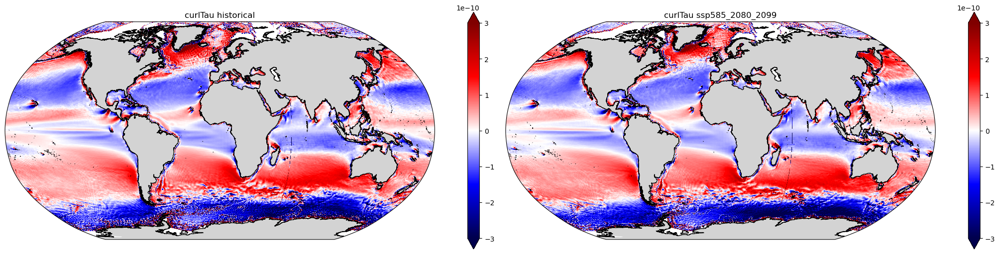

In [20]:
curlTau_one = xr.open_dataset(f'Data_Step2/{experiment_one}/curlTau.nc')['Curl_taus'].rename({'yq':'lat', 'xq':'lon'})
curlTau_two = xr.open_dataset(f'Data_Step2/{experiment_two}/curlTau.nc')['Curl_taus'].rename({'yq':'lat', 'xq':'lon'})

fig, axes = plt.subplots(1, 2, subplot_kw={'projection':ccrs.Robinson()}, figsize=(20,5), constrained_layout=True)

curlTau_one.plot(ax=axes[0], transform=ccrs.PlateCarree(), vmin=-3e-10, vmax=3e-10, cmap='seismic', cbar_kwargs={'label':''})
curlTau_two.plot(ax=axes[1], transform=ccrs.PlateCarree(), vmin=-3e-10, vmax=3e-10, cmap='seismic', cbar_kwargs={'label':''})

axes[0].set_title(f'curlTau {experiment_one}')
axes[1].set_title(f'curlTau {experiment_two}')

for i in range(2):
    axes[i].add_feature(cfeature.LAND, facecolor='lightgrey')
    axes[i].coastlines(resolution='10m')
    
plt.show()

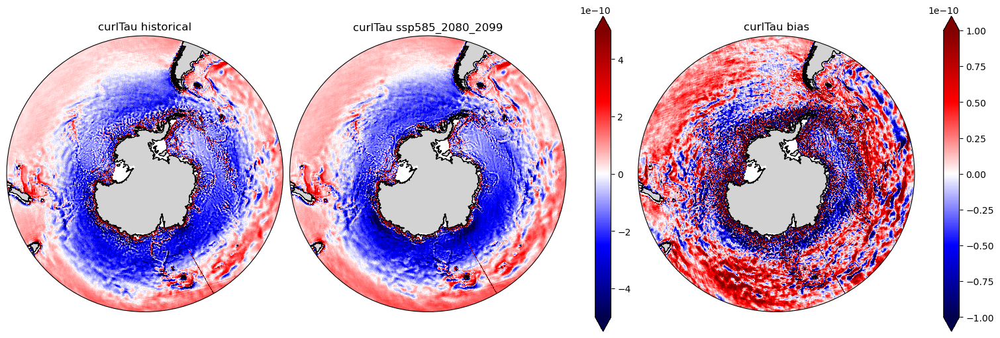

In [48]:
fig, axes = plt.subplots(1, 3, subplot_kw={'projection':ccrs.SouthPolarStereo(central_longitude=-90)}, figsize=(15,5), constrained_layout=True)

# Compute a circle in axes coordinates, which we can use as a boundary
# for the map. We can pan/zoom as much as we like - the boundary will be
# permanently circular.
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)

curlTau_one.sel(lat=slice(-90,-40)).plot(ax=axes[0], transform=ccrs.PlateCarree(), vmin=-5e-10, vmax=5e-10, cmap='seismic', add_colorbar=False)
curlTau_two.sel(lat=slice(-90,-40)).plot(ax=axes[1], transform=ccrs.PlateCarree(), vmin=-5e-10, vmax=5e-10, cmap='seismic', cbar_kwargs={'label':''})
(curlTau_two-curlTau_one).sel(lat=slice(-90,-40)).plot(ax=axes[2], transform=ccrs.PlateCarree(), vmin=-1e-10, vmax=1e-10, cmap='seismic', cbar_kwargs={'label':''})

axes[0].set_title(f'curlTau {experiment_one}')
axes[1].set_title(f'curlTau {experiment_two}')
axes[2].set_title(f'curlTau bias')

for i in range(3):
    axes[i].add_feature(cfeature.LAND, facecolor='lightgrey')
    axes[i].coastlines(resolution='10m')
    axes[i].set_boundary(circle, transform=axes[i].transAxes)

plt.savefig(f'figures/2023-07-26/southern_ocean_curlTau_and_bias.png', dpi=600)
plt.show()

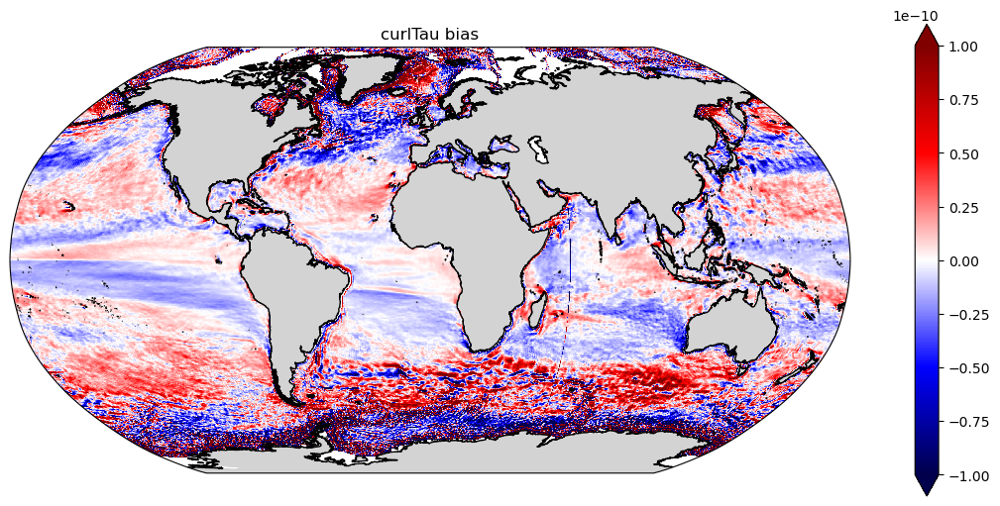

In [22]:
curlTau_bias = curlTau_two - curlTau_one

fig, axes = plt.subplots(1, 1, subplot_kw={'projection':ccrs.Robinson()}, figsize=(10,5), constrained_layout=True)

curlTau_bias.plot(ax=axes, transform=ccrs.PlateCarree(), vmin=-1e-10, vmax=1e-10, cmap='seismic', cbar_kwargs={'label':''})

axes.set_title(f'curlTau bias')

axes.add_feature(cfeature.LAND, facecolor='lightgrey')
axes.coastlines(resolution='10m')
    
plt.show()

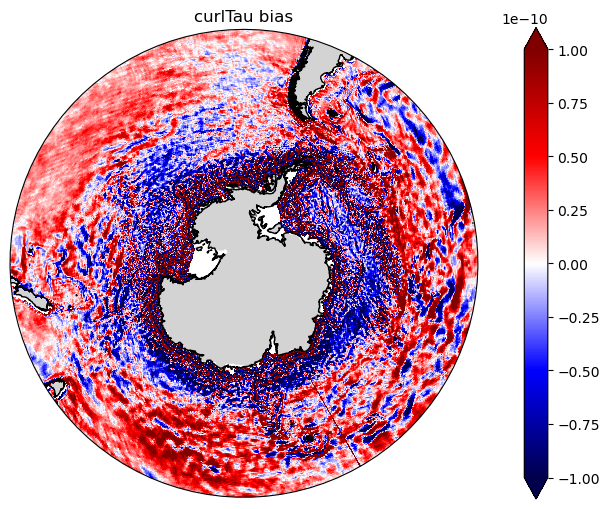

In [23]:
fig, axes = plt.subplots(1, 1, subplot_kw={'projection':ccrs.SouthPolarStereo(central_longitude=-90)}, figsize=(6,5), constrained_layout=True)

# Compute a circle in axes coordinates, which we can use as a boundary
# for the map. We can pan/zoom as much as we like - the boundary will be
# permanently circular.
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)

curlTau_bias.sel(lat=slice(-90,-40)).plot(ax=axes, transform=ccrs.PlateCarree(), vmin=-1e-10, vmax=1e-10, cmap='seismic', cbar_kwargs={'label':''})

axes.set_title(f'curlTau bias')

axes.add_feature(cfeature.LAND, facecolor='lightgrey')
axes.coastlines(resolution='10m')
axes.set_boundary(circle, transform=axes.transAxes)
    
plt.show()

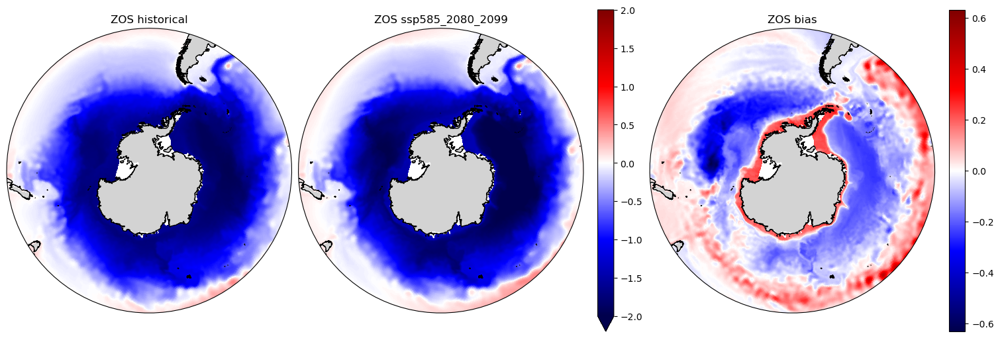

In [49]:
zos_one = xr.open_dataset(f'Data_Step2/{experiment_one}/zos.nc')['zos'].rename({'yh':'lat', 'xh':'lon'})
zos_two = xr.open_dataset(f'Data_Step2/{experiment_two}/zos.nc')['zos'].rename({'yh':'lat', 'xh':'lon'})

fig, axes = plt.subplots(1, 3, subplot_kw={'projection':ccrs.SouthPolarStereo(central_longitude=-90)}, figsize=(15,5), constrained_layout=True)

# Compute a circle in axes coordinates, which we can use as a boundary
# for the map. We can pan/zoom as much as we like - the boundary will be
# permanently circular.
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)

zos_one.sel(lat=slice(-90,-40)).plot(ax=axes[0], transform=ccrs.PlateCarree(), cmap='seismic', add_colorbar=False, vmin=-2, vmax=2)
zos_two.sel(lat=slice(-90,-40)).plot(ax=axes[1], transform=ccrs.PlateCarree(), cmap='seismic', cbar_kwargs={'label':''}, vmin=-2, vmax=2)
(zos_two-zos_one).sel(lat=slice(-90,-40)).plot(ax=axes[2], transform=ccrs.PlateCarree(), cmap='seismic', cbar_kwargs={'label':''})

axes[0].set_title(f'ZOS {experiment_one}')
axes[1].set_title(f'ZOS {experiment_two}')
axes[2].set_title(f'ZOS bias')

for i in range(3):
    axes[i].add_feature(cfeature.LAND, facecolor='lightgrey')
    axes[i].coastlines(resolution='10m')
    axes[i].set_boundary(circle, transform=axes[i].transAxes)

plt.savefig(f'figures/2023-07-26/southern_ocean_zos_and_bias.png', dpi=600)
plt.show()

# Prediction probability plots

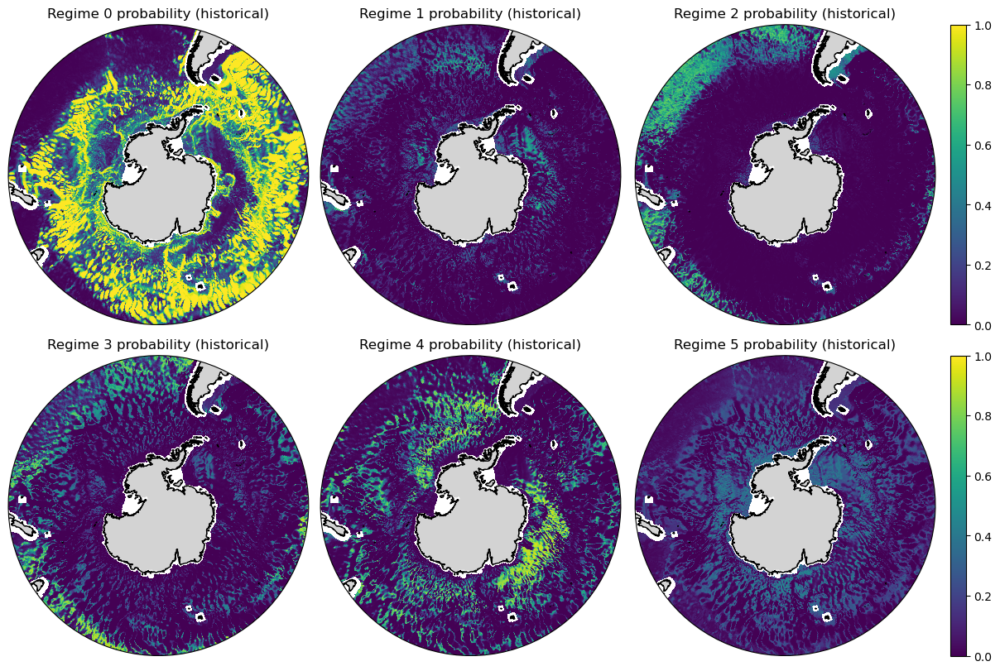

In [53]:
fig, axes = plt.subplots(2, 3, subplot_kw={'projection':ccrs.SouthPolarStereo(central_longitude=-90)}, figsize=(12,8), constrained_layout=True)

# Compute a circle in axes coordinates, which we can use as a boundary
# for the map. We can pan/zoom as much as we like - the boundary will be
# permanently circular.
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)

for i in range(num_clusters):
    
    regime_probs = pred_probs_one.sel(regime=i).sel(lat=slice(-90,-40)).rename('')
    
    add_cbar = False
    if i % 3 == 2:
        add_cbar = True
        
    regime_probs.plot(ax=axes[i//3,i%3], transform=ccrs.PlateCarree(), cmap='viridis', vmin=0, vmax=1, add_colorbar=add_cbar)
    
    axes[i//3,i%3].add_feature(cfeature.LAND, facecolor='lightgrey')
    axes[i//3,i%3].coastlines(resolution='10m')
    axes[i//3,i%3].set_boundary(circle, transform=axes[i//3,i%3].transAxes)
    axes[i//3,i%3].set_title(f'Regime {i} probability ({experiment_one})')

plt.savefig(f'figures/2023-07-26/southern_ocean_regime_probabilities_{experiment_one}.png', dpi=600)
plt.show()

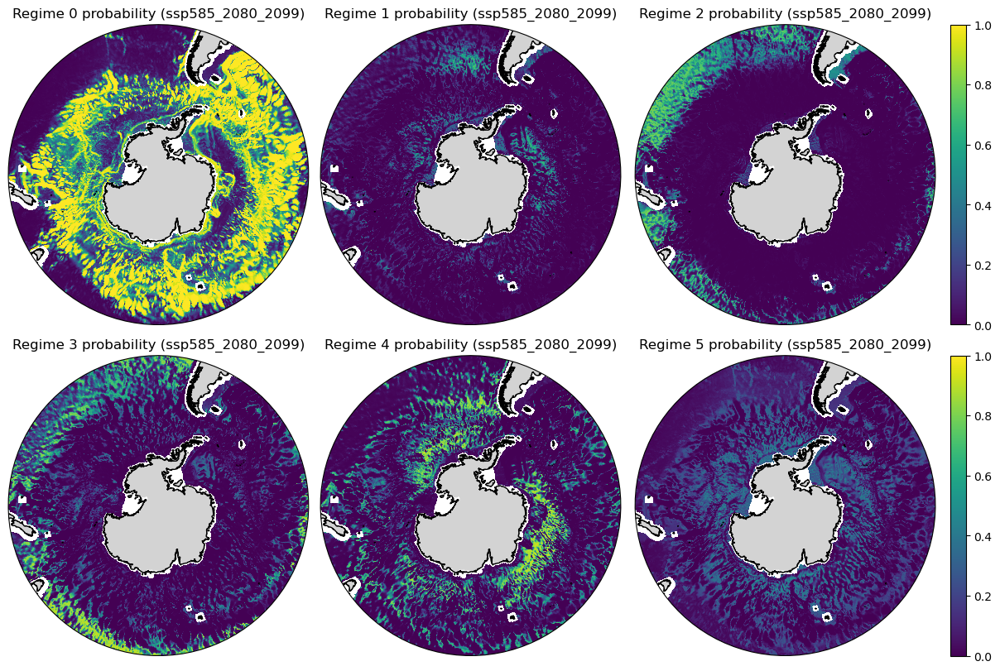

In [54]:
fig, axes = plt.subplots(2, 3, subplot_kw={'projection':ccrs.SouthPolarStereo(central_longitude=-90)}, figsize=(12,8), constrained_layout=True)

# Compute a circle in axes coordinates, which we can use as a boundary
# for the map. We can pan/zoom as much as we like - the boundary will be
# permanently circular.
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)

for i in range(num_clusters):
    
    regime_probs = pred_probs_two.sel(regime=i).sel(lat=slice(-90,-40)).rename('')
    
    add_cbar = False
    if i % 3 == 2:
        add_cbar = True
        
    regime_probs.plot(ax=axes[i//3,i%3], transform=ccrs.PlateCarree(), cmap='viridis', vmin=0, vmax=1, add_colorbar=add_cbar)
    
    axes[i//3,i%3].add_feature(cfeature.LAND, facecolor='lightgrey')
    axes[i//3,i%3].coastlines(resolution='10m')
    axes[i//3,i%3].set_boundary(circle, transform=axes[i//3,i%3].transAxes)
    axes[i//3,i%3].set_title(f'Regime {i} probability ({experiment_two})')

plt.savefig(f'figures/2023-07-26/southern_ocean_regime_probabilities_{experiment_two}.png', dpi=600)
plt.show()

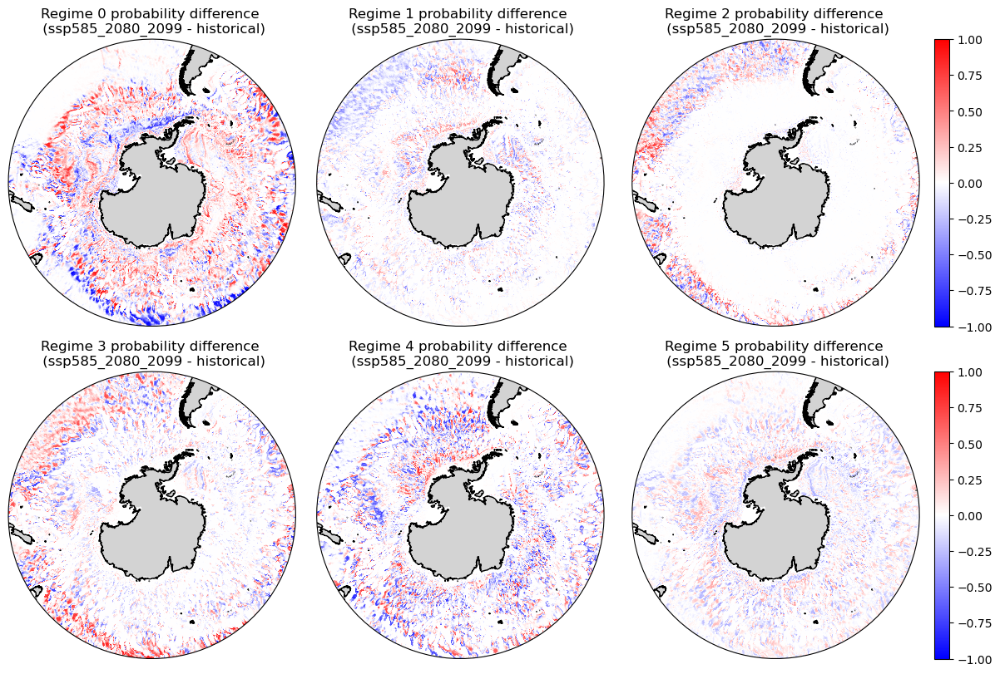

In [59]:
fig, axes = plt.subplots(2, 3, subplot_kw={'projection':ccrs.SouthPolarStereo(central_longitude=-90)}, figsize=(12,8), constrained_layout=True)

# Compute a circle in axes coordinates, which we can use as a boundary
# for the map. We can pan/zoom as much as we like - the boundary will be
# permanently circular.
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)

for i in range(num_clusters):
    
    regime_probs = pred_probs_two.sel(regime=i).sel(lat=slice(-90,-40)).rename('') - pred_probs_one.sel(regime=i).sel(lat=slice(-90,-40)).rename('')
    
    add_cbar = False
    if i % 3 == 2:
        add_cbar = True
        
    regime_probs.plot(ax=axes[i//3,i%3], transform=ccrs.PlateCarree(), cmap='bwr', vmin=-1, vmax=1, add_colorbar=add_cbar)
    
    axes[i//3,i%3].add_feature(cfeature.LAND, facecolor='lightgrey')
    axes[i//3,i%3].coastlines(resolution='10m')
    axes[i//3,i%3].set_boundary(circle, transform=axes[i//3,i%3].transAxes)
    axes[i//3,i%3].set_title(f'Regime {i} probability difference \n ({experiment_two} - {experiment_one})')
    
plt.savefig(f'figures/2023-07-26/southern_ocean_regime_probability_differences.png', dpi=600)
plt.show()

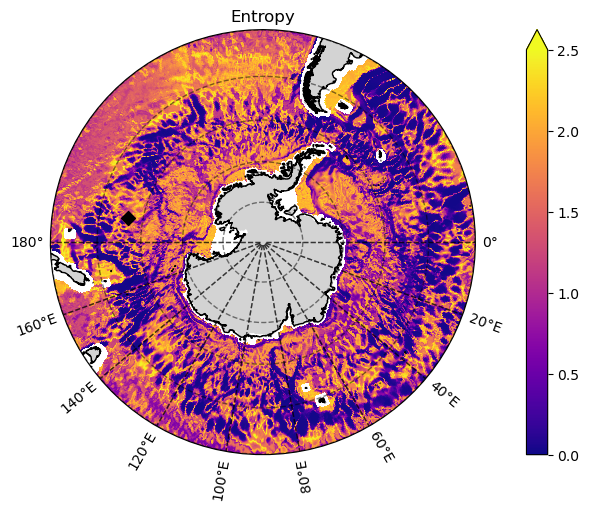

In [27]:
fig, axes = plt.subplots(1, 1, subplot_kw={'projection':ccrs.SouthPolarStereo(central_longitude=-90)}, figsize=(6,5), constrained_layout=True)

# Compute a circle in axes coordinates, which we can use as a boundary
# for the map. We can pan/zoom as much as we like - the boundary will be
# permanently circular.
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)

entropy_two.sel(lat=slice(-90,-40)).plot(ax=axes, transform=ccrs.PlateCarree(), cmap='plasma',
                                         vmin=0, vmax=2.5, cbar_kwargs={'label':''})
axes.set_title('Entropy')
axes.add_feature(cfeature.LAND, facecolor='lightgrey')
axes.coastlines(resolution='10m')
axes.set_boundary(circle, transform=axes.transAxes)

axes.scatter(-170, -56.5, transform=ccrs.PlateCarree(), marker='D', c='black', s=50)

gl = axes.gridlines(crs=ccrs.PlateCarree(), linewidth=1, color='black', alpha=0.5, linestyle='--', draw_labels=True)
gl.xlocator = mticker.FixedLocator(np.arange(0,181,20))
gl.ylocator = mticker.FixedLocator([])
gl = axes.gridlines(crs=ccrs.PlateCarree(), linewidth=1, color='black', alpha=0.5, linestyle='--', draw_labels=False)
gl.xlocator = mticker.FixedLocator(np.arange(0,181,20))

plt.show()

In [28]:
def plot_predicted_probabilities(lon, lat):
    label_ensemble_preds = []

    for i in range(num_clusters):
        label_ensemble_preds.append(pred_full_one.sel(lon=lon, method='nearest').sel(lat=lat, method='nearest').data[:,i])

    fig, ax = plt.subplots(1, 2, figsize=(15,5))
    bplot = ax[0].boxplot(label_ensemble_preds, patch_artist=True, boxprops={'fill': None})

    for i in range(num_clusters):
        bplot['boxes'][i].set_edgecolor('purple')
        bplot['medians'][i].set_color('purple')

    ax[0].set_xticklabels(list(range(num_clusters)))
    ax[0].set_xlabel('Regime')
    ax[0].set_ylabel('Probabilities')
    ax[0].set_title(f'{experiment_one} Prediction Probabilities (Lon={lon}, Lat={lat})')
    ax[0].set_ylim(0,1)
    point_entropy = entropy_one.sel(lon=lon, method='nearest').sel(lat=lat, method='nearest').data
    ax[0].text(0.6, 0.95, f'Entropy: {np.round(np.mean(point_entropy), 3)}', horizontalalignment='left', verticalalignment='center')
    
    label_ensemble_preds = []

    for i in range(num_clusters):
        label_ensemble_preds.append(pred_full_two.sel(lon=lon, method='nearest').sel(lat=lat, method='nearest').data[:,i])

    bplot = ax[1].boxplot(label_ensemble_preds, patch_artist=True, boxprops={'fill': None})

    for i in range(num_clusters):
        bplot['boxes'][i].set_edgecolor('purple')
        bplot['medians'][i].set_color('purple')

    ax[1].set_xticklabels(list(range(num_clusters)))
    ax[1].set_xlabel('Regime')
    ax[1].set_ylabel('Probabilities')
    ax[1].set_title(f'{experiment_two} Prediction Probabilities (Lon={lon}, Lat={lat})')
    ax[1].set_ylim(0,1)
    point_entropy = entropy_two.sel(lon=lon, method='nearest').sel(lat=lat, method='nearest').data
    ax[1].text(0.6, 0.95, f'Entropy: {np.round(np.mean(point_entropy), 3)}', horizontalalignment='left', verticalalignment='center')

    plt.show()

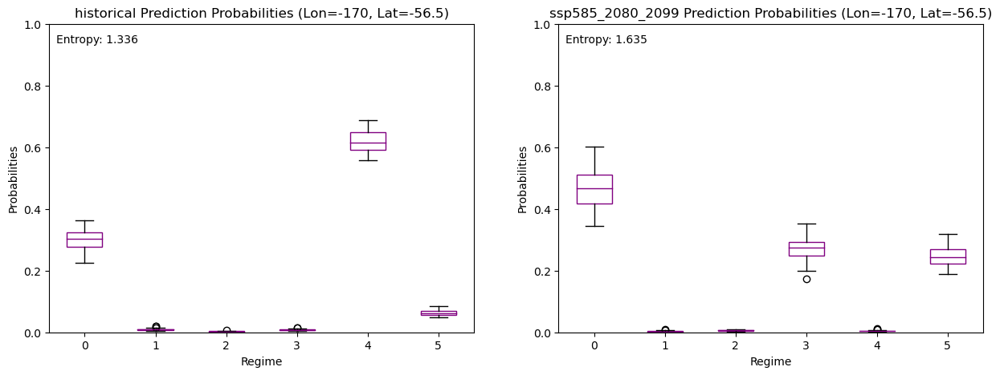

In [29]:
plot_predicted_probabilities(-170, -56.5)

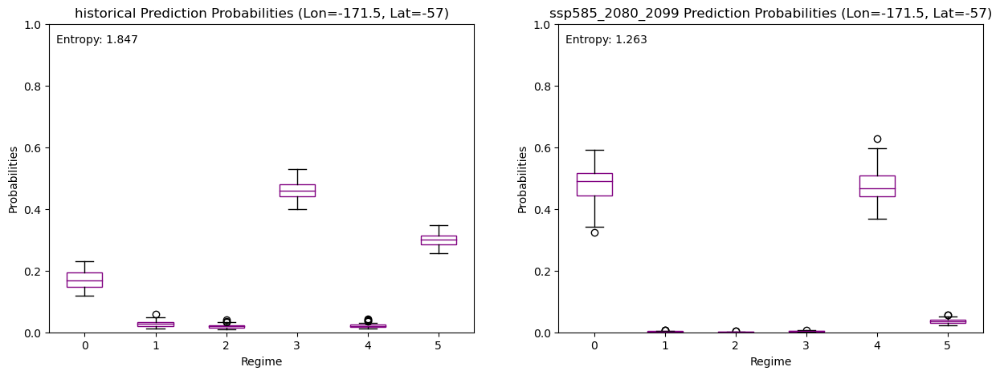

In [30]:
plot_predicted_probabilities(-171.5, -57)